# Algotytm przecinania się odcinków na płaszczyźnie

In [1]:
import sys
sys.path.insert(0, '../..')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tests.test4 import Test
from visualizer.main import Visualizer
import tkinter as tk
from matplotlib.backends.backend_tkagg import FigureCanvasTkAgg
from matplotlib.figure import Figure
from matplotlib.lines import Line2D
from sortedcontainers import SortedSet
from queue import PriorityQueue


np.random.seed(42)

# Przydatne funkcje 

In [2]:
def draw_example_1():
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))

    vis.add_line_segment(line_segments, color="black")
    vis.show()
    
def draw_example_2():
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))
    points = [(4, 2),
              (2.5, 3.5),
              (5.5, 4.5)]

    vis.add_line_segment(line_segments, color="black")
    vis.add_point(points, color="red")
    vis.show()


### Wprowadzenie
Celem ćwiczenia jest implementacja i zapoznanie się z algorytmem wyznaczającym wszystkie przecięcia się odcinków na płaszczyźnie

### Przykładowy zbiór odcinków przed wyznaczeniem punktów przecięcia

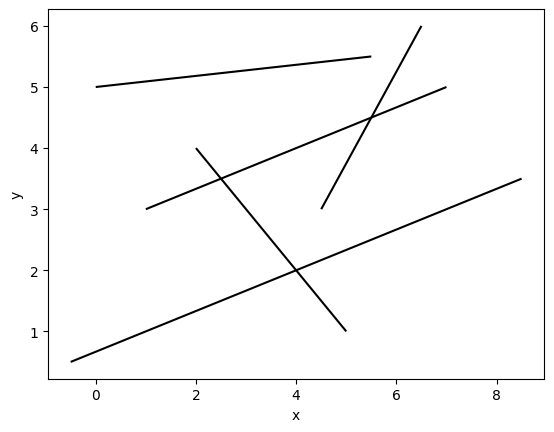

In [3]:
draw_example_1()

### Przykładowy zbiór odcinków po wyznaczenu punktów przecięcia

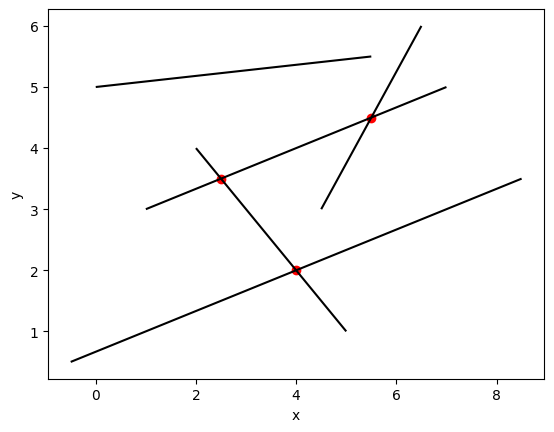

In [4]:
draw_example_2()

# Generowanie losowych odcinków na płaszczyźnie

Uzupełnij funkcję ```generate_uniform_sections```

In [5]:
def generate_uniform_sections(max_x, max_y, n):
    """
    Funkcja generuje odcinki o współrzędnych rzeczywistych w postaci par punktów. 
    Żaden wygenerowany odcinek nie jest odcinkiem pionowym.
    Żadne dwa odcinki nie mają swoich końców o takiej samej współrzędnej x.
    Zakres współrzędnych: x -> (0, max_x), y -> (0, max_y)
    :param max_x: określa maksymalną wartość współrzednej x jaka może zostać wylosowana
    :param max_y: określa maksymalną wartość współrzednej y jaka może zostać wylosowana
    :param n: ilość generowanych odcinków
    :return: tablica odcinków w postaci krotek zawierających parę krotek współrzędnych punktów końcowych odcinków
    np. [((x1, y1), (x2, y2)), ((x3, y3), (x4, y4)),...]
    """
    sections = []
    xs = set()

    while len(sections) < n:
        start_x = np.random.uniform(0, max_x)
        if start_x not in xs:
            end_x = np.random.uniform(start_x, max_x)
            if start_x != end_x and end_x not in xs:
                start_y = np.random.uniform(0, max_y)
                end_y = np.random.uniform(0, max_y)
                sections.append(((start_x, start_y), (end_x, end_y)))
                xs.add(start_x)
                xs.add(end_x)

    return sections

In [6]:
Test().runtest(1, generate_uniform_sections)

Lab 4, task 1:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.109s


<span style="color:red">Ćw.</span> Wygeneruj $\large20$ losowych odcinków w przestrzeni 2D o współrzędnych z przedziału $\large x \in \langle 0,1000 \rangle$ oraz $\large y \in \langle 0,1000\rangle$. 

In [7]:
sections = generate_uniform_sections(1000, 1000, 20)
for a, b in sections:
    print(a[0], a[1], b[0], b[1])

859.9488985183879 441.34424654286084 922.4464209557924 669.0778473873946
645.7493603105314 943.2786045140967 739.9708433518083 986.3299793326556
525.989014296185 554.3179634236236 792.0896797921057 485.78740817826093
945.1870536778255 107.95817625538906 958.6026565258451 929.5472843248313
213.0383142111527 203.8733092321151 802.5948741523725 960.1860156223588
791.1217703373095 950.984820111659 983.0219956876042 84.42438426899979
433.3888558249475 802.4561041262308 800.6097293287951 241.47174441440245
914.6048593892883 866.1764015406867 933.4751640842625 512.71257966419
515.4221718701897 103.5052314186905 696.657000728806 347.0900631195382
426.736714982473 739.0952904101334 701.3418994545955 352.07011046505863
406.5928603139864 752.5672946335956 944.27824019145 22.855769503791535
812.0887577230376 939.7677413678219 998.1103503322449 835.9558994960897
629.1737473372672 654.4306113800963 732.3346895201041 695.5924708758644
281.55816103067053 396.92385909227033 464.9976459340181 641.146969

Zwizualizuj otrzymane odcinki

In [8]:
def draw_lines(sections):
    vis = Visualizer()
    vis.add_line_segment(sections, color="black")
    vis.add_point([sections[i // 2][i % 2] for i in range(2 * len(sections))], s=10, color="black")
    return vis

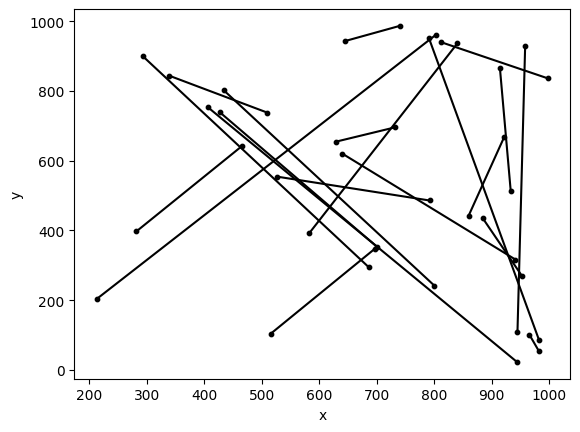

In [9]:
vis = draw_lines(sections)
vis.show()

Uzupełnij funkcję ```add_section``` #interaktywne dodawanie odcinków przez rysowanie myszką

In [10]:
def add_sections():
    root = tk.Tk()
    root.title("SectionSelector")
    root.geometry("500x500")

    fig = Figure(figsize=(5, 3), dpi=100)
    ax = fig.add_subplot(111)
    ax.grid()
    ax.scatter([0,0,100,100], [100,0,100,0], s=15, color="red")
    ax.set_xlabel("X")
    ax.set_ylabel("Y")

    previous_point = None
    section = []

    def save_polygon():
            file_name = file_name_entry.get()
            
            if file_name != "" and file_name != "ERROR":
                with open(file_name, "w") as f:
                    for points in section:
                        f.write(f"{points[0][0]} {points[0][1]} {points[1][0]} {points[1][1]}\n")
            else:
                file_name_entry.delete(0, tk.END) 
                file_name_entry.insert(0, "ERROR")

    def reset_polygon():
        section.clear()
        ax.cla()
        ax.grid()
        ax.scatter([0,0,100,100], [100,0,100,0], s=15, color="red")
        ax.set_xlabel("X")
        ax.set_ylabel("Y")
        canvas.draw()    
        canvas.draw()

        file_name = file_name_entry.get()
        if file_name != "":
            with open(file_name, "w") as f:
                pass

        file_name_entry.delete(0, tk.END)

    def exit():
        root.destroy()

    def on_click(event):
        nonlocal previous_point
        if event.xdata is None or event.ydata is None:
            return 

        point = (event.xdata, event.ydata)
        if previous_point == None:
            previous_point = point
        else:
            section.append((previous_point, point))
            line = Line2D([previous_point[0], point[0]], [previous_point[1], point[1]], color="black", linewidth=1)
            ax.add_line(line)
            canvas.draw()
            previous_point = None

        ax.scatter(point[0], point[1], s=15, color='black')
        canvas.draw()

    canvas = FigureCanvasTkAgg(fig, master=root)
    canvas.draw()
    canvas.get_tk_widget().pack(fill=tk.BOTH, expand=True)

    canvas.mpl_connect("button_press_event", on_click)

    button_frame = tk.Frame(root)
    button_frame.pack(pady=10)
    file_name_entry = tk.Entry(button_frame, width=20)
    save_button = tk.Button(button_frame, text="save", command=save_polygon)
    reset_button = tk.Button(button_frame, text="reset", command=reset_polygon)
    exit_button = tk.Button(button_frame, text="exit", command=exit)
    reset_button.pack(side="left", pady=5, padx=5)
    file_name_entry.pack(side="left", pady=5, padx=5)
    save_button.pack(side="left", pady=5, padx=5)
    exit_button.pack(side="left", pady=5, padx=5)
    root.mainloop()

    return section

In [11]:
add_sections()

[]

In [12]:
def read_sections(file_name=None):
    section = []

    if not file_name:
        print("Incorrect file name")
        return
    with open(file_name, "r") as f:
        lines = f.readlines()
        lines = [list(map(float, line.rstrip("\n").split(" "))) for line in lines]
        section = [((line[0], line[1]), (line[2], line[3])) for line in lines]

    return section

In [13]:
read_sections("example")

[((2.806451612903224, 37.52252252252254),
  (18.13548387096774, 70.66280566280568)),
 ((16.148387096774194, 57.14929214929217),
  (22.961290322580645, 36.55727155727158)),
 ((25.516129032258064, 49.74903474903477),
  (29.490322580645163, 68.73230373230376)),
 ((40.27741935483871, 62.29729729729731),
  (59.58064516129033, 32.69626769626771)),
 ((46.806451612903224, 33.983268983269),
  (79.73548387096776, 78.06306306306308)),
 ((66.10967741935485, 79.6718146718147),
  (83.14193548387098, 35.27027027027029)),
 ((73.20645161290324, 82.24581724581728),
  (77.7483870967742, 35.27027027027029))]

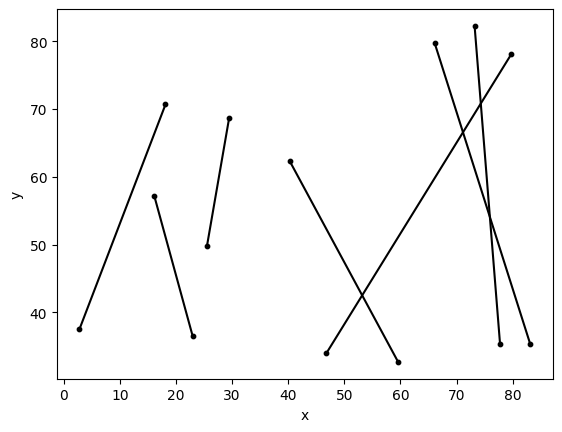

In [14]:
sections = read_sections("example")
vis = draw_lines(sections)
vis.show()

Uzupełnij funkcję ```is_intersection```

In [15]:
epsilon = 1e-12

In [16]:
from enum import Enum

class Type(Enum):
    START = 0
    END = 1
    INTERSECTION = 2

In [17]:
class Point():
    x: float
    y: float
    type: Type
    section_index: int

    def __init__(self, x, y, type, index):
        self.x = x
        self.y = y
        self.type = type
        self.section_index = index
    
    def __hash__(self):
        return hash((self.x, self.y))
    
    def __eq__(self, other):
        if not isinstance(other, Point):
            return False
        return abs(self.x - other.x) < epsilon and abs(self.y - other.y) < epsilon
    
    def __lt__(self, other):
        return self.x - other.x < -epsilon

In [18]:
class Intersection(Point):
    second_section_index: int

    def __init__(self, x, y, type, index, second_index):
        super().__init__(x, y, type, index)
        self.second_section_index = second_index


In [19]:
class Section():
    start: Point
    end: Point
    a: float
    b: float
    index: int

    sweeper_x = None

    def __init__(self, start, end, index):
        self.start = start
        self.end = end
        self.a = (end.y - start.y) / (end.x - start.x)
        self.b = start.y - self.a * start.x
        self.index = index

    def update_sweeper_x(x):
        Section.sweeper_x = x
        
    def __hash__(self):
        return self.index
    
    def __eq__(self, other):
        if not isinstance(other, Section):
            return False
        return self.index == other.index
    
    def __lt__(self, other):
        self_y = self.a * Section.sweeper_x + self.b
        other_y = other.a * Section.sweeper_x + other.b
        if abs(self_y - other_y) > epsilon:
            return self_y < other_y
        if abs(self.a - other.a) > epsilon:
            return self.a < other.a
        return self.index < other.index

In [20]:
def are_intersecting(section_first, section_second, unavailable):
    first_index = section_first.index
    second_index = section_second.index

    if first_index > second_index:
        section_first, section_second = section_second, section_first
        first_index, second_index = second_index, first_index

    if (first_index, second_index) not in unavailable:
        unavailable.add((first_index, second_index))
        if abs(section_first.a - section_second.a) < epsilon: return False
        x = (section_second.b - section_first.b) / (section_first.a - section_second.a)

        start_boundary = max(section_first.start.x, section_second.start.x)
        end_boundary = min(section_first.end.x, section_second.end.x)

        if start_boundary <= x and x <= end_boundary:
            y = section_first.a * x + section_first.b
            return (x, y)

    return False

In [21]:
def is_intersection(sections):
    """
    Funkcja sprawdza czy jakakolwiek para podanych odcinków się przecina 
    :param sections: tablica odcinków w postaci krotek krotek współrzędnych punktów końcowych odcinków
    :param eps: epsilon będący dokładnością, z jaką porównujemy liczby zmiennoprzecinkowe
    :return: True / False
    """
    n = len(sections)
    unavailable = set()
    section_objects = []
    Q = []
    T = SortedSet()
    
    for i in range(n):
        a, b = sections[i]
        first = min(a, b)
        second = max(a, b)

        start = Point(first[0], first[1], Type.START, i)
        end = Point(second[0], second[1], Type.END, i)

        Q.append(start)
        Q.append(end)
        section_objects.append(Section(start, end, i))

    Q.sort()

    for point in Q:
        Section.update_sweeper_x(point.x)
        current_section = section_objects[point.section_index]
        if point.type == Type.START:
            T.add(current_section)
            current_section_index_in_T = T.index(current_section)
            if current_section_index_in_T - 1 >= 0 and are_intersecting(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T].index], unavailable):
                return True
            if current_section_index_in_T + 1 < len(T) and are_intersecting(section_objects[T[current_section_index_in_T].index], section_objects[T[current_section_index_in_T + 1].index], unavailable):
                return True
        elif point.type == Type.END:
            current_section_index_in_T = T.index(current_section)
            if current_section_index_in_T - 1 >= 0 and current_section_index_in_T + 1 < len(T) and are_intersecting(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T + 1].index], unavailable):
                return True
            T.discard(current_section)

    return False

In [22]:
Test().runtest(2, is_intersection)

Lab 4, task 2:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.000s


Uzupełnij funkcję ```is_intersection_with_visualization```

In [23]:
def is_intersection_with_visualization(sections):
    """
    Funkcja sprawdza czy jakakolwiek para podanych odcinków się przecina i dodatkowo zwraca kolejne kroki w wizualizacji 
    :param sections: tablica odcinków w postaci krotek ktorek współrzędnych punktów końcowych odcinków
    :return: True / False
    """
    n = len(sections)
    vis = Visualizer()
    vis.add_line_segment(sections, color="black")
    starting_points = []
    ending_points = []
    for i in range(n):
        starting_points.append(min(sections[i][0], sections[i][1]))
    for i in range(n):
        ending_points.append(max(sections[i][0], sections[i][1]))
    vis.add_point(starting_points, color="blue", s=20)
    vis.add_point(ending_points, color="darkblue", s=20)
    unavailable = set()
    section_objects = []
    Q = []
    T = SortedSet()

    for i in range(n):
        a, b = sections[i]
        first = min(a, b)
        second = max(a, b)
        start = Point(first[0], first[1], Type.START, i)
        end = Point(second[0], second[1], Type.END, i)
        Q.append(start)
        Q.append(end)
        section_objects.append(Section(start, end, i))

    Q.sort()

    for point in Q:
        Section.update_sweeper_x(point.x)
        current_section = section_objects[point.section_index]
        sweep_line = vis.add_line(((point.x, current_section.start.y), (point.x, current_section.end.y)), color = "red")
        current_point = vis.add_point((point.x, point.y), color="red", s=20)
        if point.type == Type.START:
            T.add(current_section)
            vis.add_point([sections[current_section.index][0], sections[current_section.index][1]], color="green", s=20)
            vis.add_line_segment(sections[current_section.index], color="green")    
            current_section_index_in_T = T.index(current_section)
            first_points = vis.add_point([sections[current_section.index][0], sections[current_section.index][1]], color="purple", s=20)
            first_line = vis.add_line_segment(sections[current_section.index], color="purple")
            if current_section_index_in_T - 1 >= 0:
                second_points = vis.add_point([sections[T[current_section_index_in_T - 1].index][0], sections[T[current_section_index_in_T - 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T - 1].index], color="purple")
                if (point := are_intersecting(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T].index], unavailable)):
                    vis.add_point(point, color="red", s=20)
                    return True, vis
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            if current_section_index_in_T + 1 < len(T):
                second_points = vis.add_point([sections[T[current_section_index_in_T - 1].index][0], sections[T[current_section_index_in_T + 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T + 1].index], color="purple")
                if (point := are_intersecting(section_objects[T[current_section_index_in_T].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)):
                    vis.add_point(point, color="red", s=20)
                    return True, vis
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            vis.remove_figure(first_line)
            vis.remove_figure(first_points)
        elif point.type == Type.END:
            current_section_index_in_T = T.index(current_section)
            if current_section_index_in_T - 1 >= 0 and current_section_index_in_T + 1 < len(T):
                first_points = vis.add_point([sections[T[current_section_index_in_T - 1].index][0], sections[T[current_section_index_in_T + 1].index][1]], color="purple", s=20)
                first_line = vis.add_line_segment(sections[T[current_section_index_in_T - 1].index], color="purple")
                second_points = vis.add_point([sections[T[current_section_index_in_T + 1].index][0], sections[T[current_section_index_in_T - 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T + 1].index], color="purple")
                if (point := are_intersecting(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)):
                    vis.add_point(point, color="red", s=20)
                    return True
                vis.remove_figure(first_line)
                vis.remove_figure(first_points)
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            vis.add_point([sections[point.section_index][0], sections[point.section_index][1]], color="grey", s=20)
            vis.add_line_segment(sections[point.section_index], color="grey")
            T.discard(current_section)
        vis.remove_figure(sweep_line)
        vis.remove_figure(current_point)

    return False, vis

Uzupełnij funkcję ```find_intersections```

In [24]:
def find_intersection(section_first, section_second, unavailable):
    first_index = section_first.index
    second_index = section_second.index

    if first_index > second_index:
        section_first, section_second = section_second, section_first
        first_index, second_index = second_index, first_index

    if (first_index, second_index) not in unavailable:
        unavailable.add((first_index, second_index))
        if abs(section_first.a - section_second.a) < epsilon: return None
        x = (section_second.b - section_first.b) / (section_first.a - section_second.a)

        start_boundary = max(section_first.start.x, section_second.start.x)
        end_boundary = min(section_first.end.x, section_second.end.x)

        if start_boundary <= x and x <= end_boundary:
            y = section_first.a * x + section_first.b
            return Intersection(x, y, Type.INTERSECTION, first_index, second_index)

    return None

In [25]:
def find_intersections(sections):
    n = len(sections)
    unavailable = set()
    section_objects = []
    Q = PriorityQueue()
    T = SortedSet()
    intersections = []
    
    for i in range(n):
        a, b = sections[i]
        first = min(a, b)
        second = max(a, b)

        start = Point(first[0], first[1], Type.START, i)
        end = Point(second[0], second[1], Type.END, i)

        Q.put(start)
        Q.put(end)
    
        section_objects.append(Section(start, end, i))

    while not Q.empty():
        point = Q.get()
        current_section = section_objects[point.section_index]
        if point.type == Type.START:
            Section.update_sweeper_x(point.x)
            T.add(current_section)
            current_section_index_in_T = T.index(current_section)
            if (current_section_index_in_T - 1 >= 0) and ((intersection := find_intersection(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T].index], unavailable)) is not None):
                Q.put(intersection)
                intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
            if (current_section_index_in_T + 1 < len(T)) and ((intersection := find_intersection(section_objects[T[current_section_index_in_T].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)) is not None):
                Q.put(intersection)
                intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
        elif point.type == Type.END:
            Section.update_sweeper_x(point.x)
            current_section_index_in_T = T.index(current_section)
            if (current_section_index_in_T - 1 >= 0 and current_section_index_in_T + 1 < len(T)) and ((intersection := find_intersection(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)) is not None):
                Q.put(intersection)
                intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
            T.discard(current_section)
        else:
            T.remove(section_objects[point.section_index])
            T.remove(section_objects[point.second_section_index])
            Section.update_sweeper_x(point.x + epsilon)
            T.add(section_objects[point.section_index])
            T.add(section_objects[point.second_section_index])
            i, j = T.index(section_objects[point.section_index]), T.index(section_objects[point.second_section_index])
            lower_index = min(i, j)
            upper_index = max(i, j)
            if lower_index - 1 >= 0  and ((intersection := find_intersection(section_objects[T[lower_index - 1].index], section_objects[T[lower_index].index], unavailable)) is not None):
                Q.put(intersection)
                intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
            if upper_index + 1 < len(T) and ((intersection := find_intersection(section_objects[T[upper_index].index], section_objects[T[upper_index + 1].index], unavailable)) is not None):
                Q.put(intersection)
                intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))

    return intersections

In [26]:
Test().runtest(3, find_intersections)

Lab 4, task 3:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.000s


Uzupełnij funkcję ```find_intersections_with_visualization```

In [27]:
def find_intersections_with_visualization(sections):
    """
    Funkcja znajduje wszystkie przecięcia zadanych odcinków i dodatkowo zwraca kolejne kroki w wizualizacji 
    :param sections: tablica odcinków w postaci krotek ktorek współrzędnych punktów końcowych odcinków
    :return: tablica punktów przecięć w postaci trzyelementowych krotek w których pierwszym elementem są współrzędne danego punktu, a drugim i trzecim indeksy prostych z listy wejściowej, które się przecinają w tym punkcie współrzędnych np.:
    [((x1, y1), id1,id2),
    ((x2, y2), id3, id4),
    ...]
    """
    n = len(sections)
    vis = Visualizer()
    vis.add_line_segment(sections, color="black")
    starting_points = []
    ending_points = []
    for i in range(n):
        starting_points.append(min(sections[i][0], sections[i][1]))
    for i in range(n):
        ending_points.append(max(sections[i][0], sections[i][1]))
    vis.add_point(starting_points, color="blue", s=20)
    vis.add_point(ending_points, color="darkblue", s=20)
    
    unavailable = set()
    section_objects = []
    Q = PriorityQueue()
    T = SortedSet()
    intersections = []
    
    for i in range(n):
        a, b = sections[i]
        first = min(a, b)
        second = max(a, b)

        start = Point(first[0], first[1], Type.START, i)
        end = Point(second[0], second[1], Type.END, i)

        Q.put(start)
        Q.put(end)
    
        section_objects.append(Section(start, end, i))

    while not Q.empty():
        point = Q.get()
        current_section = section_objects[point.section_index]
        sweep_line = vis.add_line(((point.x, current_section.start.y), (point.x, current_section.end.y)), color = "red")
        current_point = vis.add_point((point.x, point.y), color="red", s=20)
        if point.type == Type.START:
            Section.update_sweeper_x(point.x)
            T.add(current_section)
            vis.add_point([sections[current_section.index][0], sections[current_section.index][1]], color="green", s=20)
            vis.add_line_segment(sections[current_section.index], color="green") 
            current_section_index_in_T = T.index(current_section)
            first_points = vis.add_point([sections[current_section.index][0], sections[current_section.index][1]], color="purple", s=20)
            first_line = vis.add_line_segment(sections[current_section.index], color="purple")
            if current_section_index_in_T - 1 >= 0:
                second_points = vis.add_point([sections[T[current_section_index_in_T - 1].index][0], sections[T[current_section_index_in_T - 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T - 1].index], color="purple")
                if (intersection := find_intersection(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T].index], unavailable)) is not None:
                    vis.add_point((intersection.x, intersection.y), color="red", s=20)
                    Q.put(intersection)
                    intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            if current_section_index_in_T + 1 < len(T):
                second_points = vis.add_point([sections[T[current_section_index_in_T + 1].index][0], sections[T[current_section_index_in_T - 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T + 1].index], color="purple")
                if (intersection := find_intersection(section_objects[T[current_section_index_in_T].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)) is not None:
                    Q.put(intersection)
                    intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
                    vis.add_point((intersection.x, intersection.y), color="red", s=20)
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            vis.remove_figure(first_line)
            vis.remove_figure(first_points)
        elif point.type == Type.END:
            Section.update_sweeper_x(point.x)
            current_section_index_in_T = T.index(current_section)
            if current_section_index_in_T - 1 >= 0 and current_section_index_in_T + 1 < len(T):
                first_points = vis.add_point([sections[T[current_section_index_in_T - 1].index][0], sections[T[current_section_index_in_T + 1].index][1]], color="purple", s=20)
                first_line = vis.add_line_segment(sections[T[current_section_index_in_T - 1].index], color="purple")
                second_points = vis.add_point([sections[T[current_section_index_in_T + 1].index][0], sections[T[current_section_index_in_T - 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[current_section_index_in_T + 1].index], color="purple")
                if (intersection := find_intersection(section_objects[T[current_section_index_in_T - 1].index], section_objects[T[current_section_index_in_T + 1].index], unavailable)) is not None:
                    Q.put(intersection)
                    intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
                    vis.add_point((intersection.x, intersection.y), color="red", s=20)
                vis.remove_figure(first_line)
                vis.remove_figure(first_points)
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            vis.add_point([sections[point.section_index][0], sections[point.section_index][1]], color="grey", s=20)
            vis.add_line_segment(sections[point.section_index], color="gray")
            T.discard(current_section)
        else:
            T.remove(section_objects[point.section_index])
            T.remove(section_objects[point.second_section_index])
            Section.update_sweeper_x(point.x + epsilon)
            T.add(section_objects[point.section_index])
            T.add(section_objects[point.second_section_index])
            i, j = T.index(section_objects[point.section_index]), T.index(section_objects[point.second_section_index])
            lower_index = min(i, j)
            upper_index = max(i, j)
            if lower_index - 1 >= 0:
                first_points = vis.add_point([sections[T[lower_index - 1].index][0], sections[T[lower_index - 1].index][1]], color="purple", s=20)
                first_line = vis.add_line_segment(sections[T[lower_index - 1].index], color="purple")
                second_points = vis.add_point([sections[T[lower_index].index][0], sections[T[lower_index].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[lower_index].index], color="purple")
                if (intersection := find_intersection(section_objects[T[lower_index - 1].index], section_objects[T[lower_index].index], unavailable)) is not None:
                    Q.put(intersection)
                    intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
                    vis.add_point((intersection.x, intersection.y), color="red", s=20)
                vis.remove_figure(first_line)
                vis.remove_figure(first_points)
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
            if upper_index + 1 < len(T):
                first_points = vis.add_point([sections[T[upper_index].index][0], sections[T[upper_index].index][1]], color="purple", s=20)
                first_line = vis.add_line_segment(sections[T[upper_index].index], color="purple")
                second_points = vis.add_point([sections[T[upper_index + 1].index][0], sections[T[upper_index + 1].index][1]], color="purple", s=20)
                second_line = vis.add_line_segment(sections[T[upper_index].index], color="purple")
                if (intersection := find_intersection(section_objects[T[upper_index].index], section_objects[T[upper_index + 1].index], unavailable)) is not None:
                    Q.put(intersection)
                    intersections.append(((intersection.x, intersection.y), intersection.section_index+1, intersection.second_section_index+1))
                    vis.add_point((intersection.x, intersection.y), color="red", s=20)
                vis.remove_figure(first_line)
                vis.remove_figure(first_points)
                vis.remove_figure(second_line)
                vis.remove_figure(second_points)
        vis.remove_figure(sweep_line)
        vis.remove_figure(current_point)
        
    return intersections, vis

A: True
B: False
C: True
D: True


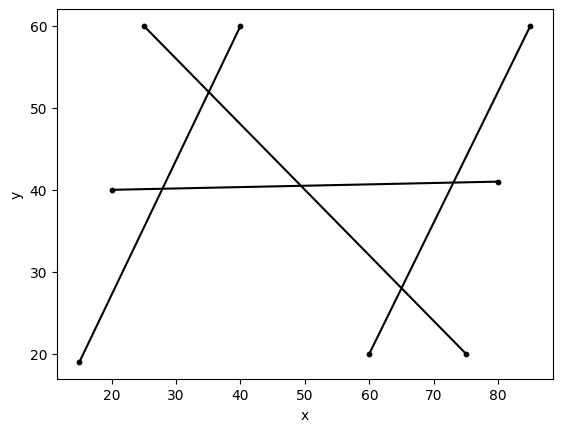

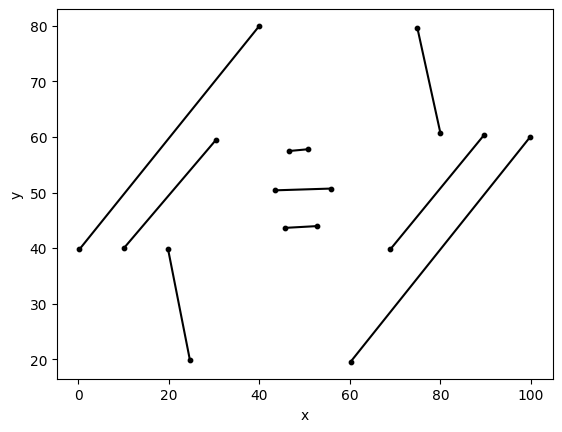

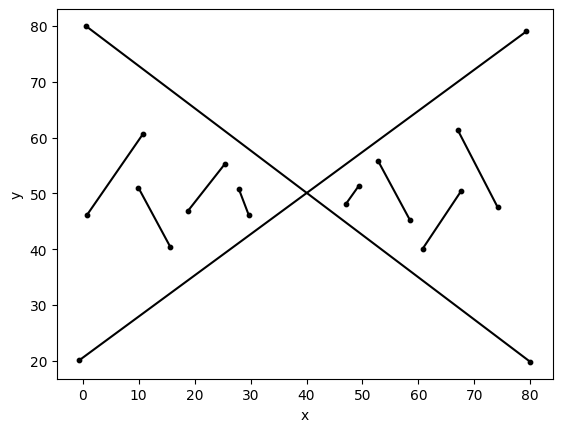

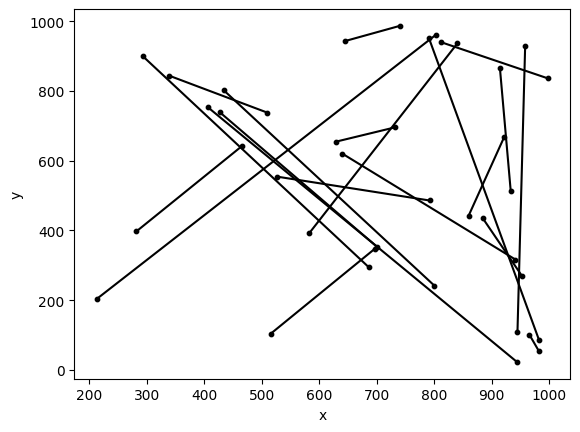

In [28]:
sections_file_names = ["A", "B", "C", "D"]
for sections_file_name in sections_file_names:
    sections = read_sections(sections_file_name)
    vis = draw_lines(sections)
    vis.show()
    print(f"{sections_file_name}: {is_intersection(sections)}")

A
liczba znalezionych puntkow przeciec: 5
punkty przeciec:
(27.88501026694045, 40.13141683778234)
(49.38775510204081, 40.48979591836734)
(35.08196721311475, 51.93442622950819)
(64.99999999999999, 27.999999999999986)
(73.05263157894736, 40.88421052631578)
B
liczba znalezionych puntkow przeciec: 0
punkty przeciec:
C
liczba znalezionych puntkow przeciec: 1
punkty przeciec:
(40.04241349287496, 50.087803492793526)
D
liczba znalezionych puntkow przeciec: 29
punkty przeciec:
(462.7893393904151, 638.20692865964)
(692.0981315490843, 365.09816360935076)
(452.6155549570083, 773.0844690144862)
(503.182413653887, 576.0847033595471)
(520.3785536567021, 598.1447737051155)
(672.8683709512487, 315.11745930352185)
(523.711415727428, 602.4203362278824)
(545.7910074444759, 630.7451432136229)
(558.9216318280794, 545.8366221201818)
(564.9630938161903, 544.2807269337967)
(609.9797568366637, 532.6873064275495)
(599.6152261683083, 427.77658335195713)
(617.7376142044847, 466.01540732041303)
(618.8416477198831, 

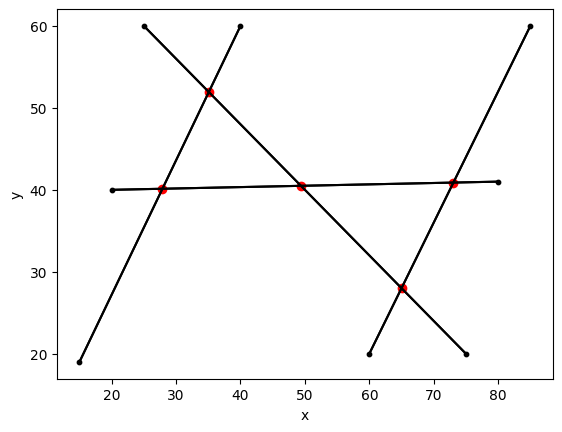

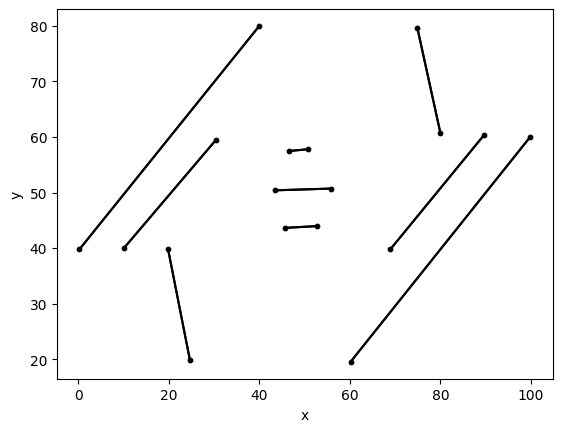

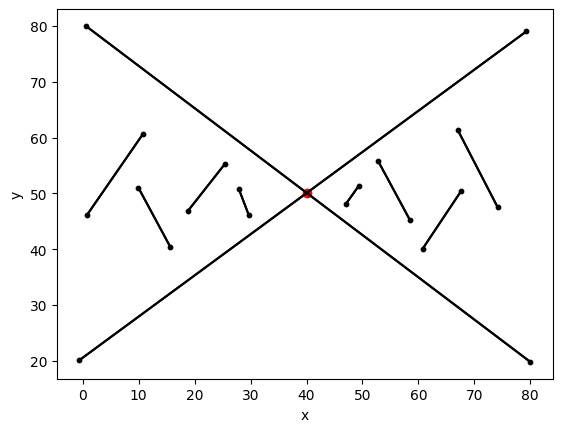

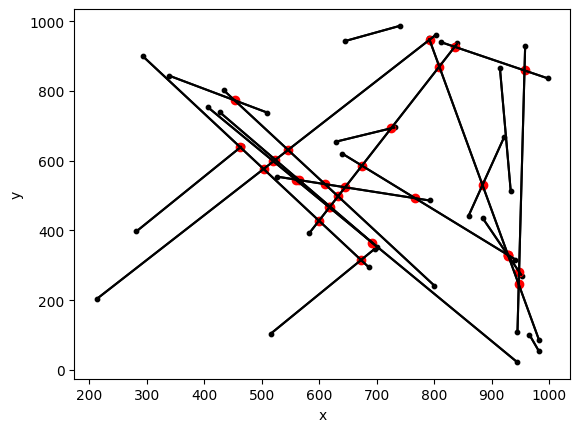

In [29]:
sections_file_names = ["A", "B", "C", "D"]
for sections_file_name in sections_file_names:
    sections = read_sections(sections_file_name)
    intersections = find_intersections(sections)
    n = len(intersections)
    points = [intersections[i][0] for i in range(n)]
    vis = draw_lines(sections)
    vis.add_line_segment(sections, color="black")
    vis.add_point(points, color="red")
    print(f"{sections_file_name}")
    print(f"liczba znalezionych puntkow przeciec: {n}")
    print(f"punkty przeciec:")
    for i in range(n):
        print(f"({intersections[i][0][0]}, {intersections[i][0][1]})")
    vis.show()

[((20.0, 40.0), (80.0, 41.0)), ((15.0, 19.0), (40.0, 60.0)), ((60.0, 20.0), (85.0, 60.0)), ((25.0, 60.0), (75.0, 20.0))]


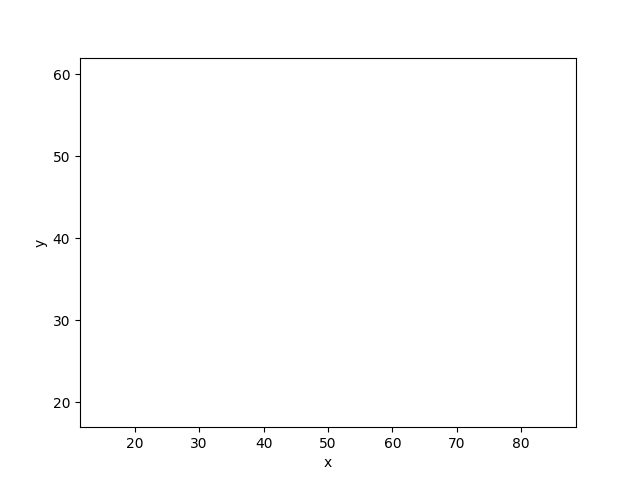

In [30]:
sections_file_name = "A"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = is_intersection_with_visualization(sections)
vis.show_gif()

[((0.251612903225805, 39.77477477477479), (39.99354838709677, 79.993564993565)), ((60.148387096774194, 19.504504504504524), (99.89032258064518, 60.045045045045065)), ((68.94838709677418, 39.77477477477479), (89.6709677419355, 60.36679536679538)), ((10.187096774193549, 40.09652509652511), (30.34193548387097, 59.40154440154442)), ((19.838709677419352, 39.77477477477479), (24.664516129032258, 19.826254826254846)), ((80.01935483870969, 60.68854568854571), (74.90967741935484, 79.6718146718147)), ((43.4, 50.392535392535414), (55.89032258064517, 50.71428571428573)), ((45.67096774193548, 43.63577863577866), (52.767741935483876, 43.95752895752897)), ((46.52258064516129, 57.47104247104249), (50.78064516129033, 57.79279279279282))]


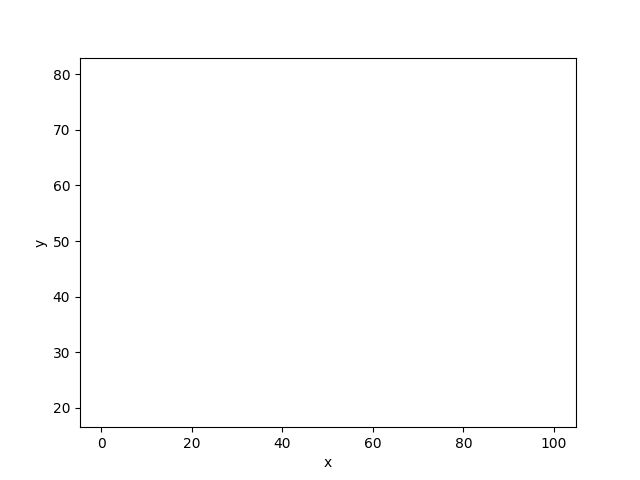

In [31]:
sections_file_name = "B"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = is_intersection_with_visualization(sections)
vis.show_gif()

[((0.5354838709677416, 79.993564993565), (80.01935483870969, 19.826254826254846)), ((-0.6000000000000014, 20.14800514800517), (79.32832258064518, 79.02831402831404)), ((0.7954193548387067, 46.209781209781234), (10.790516129032255, 60.68854568854571)), ((9.933793548387094, 51.03603603603606), (15.64527741935484, 40.418275418275435)), ((18.786593548387096, 46.85328185328188), (25.354800000000004, 55.21879021879024)), ((27.92496774193549, 50.71428571428573), (29.638412903225813, 46.209781209781234)), ((47.05843870967743, 48.14028314028315), (49.343032258064525, 51.357786357786374)), ((52.76992258064517, 55.862290862290884), (58.48140645161291, 45.24453024453026)), ((60.766000000000005, 40.09652509652511), (67.6197806451613, 50.392535392535414)), ((67.04863225806453, 61.33204633204635), (74.18798709677421, 47.49678249678251))]


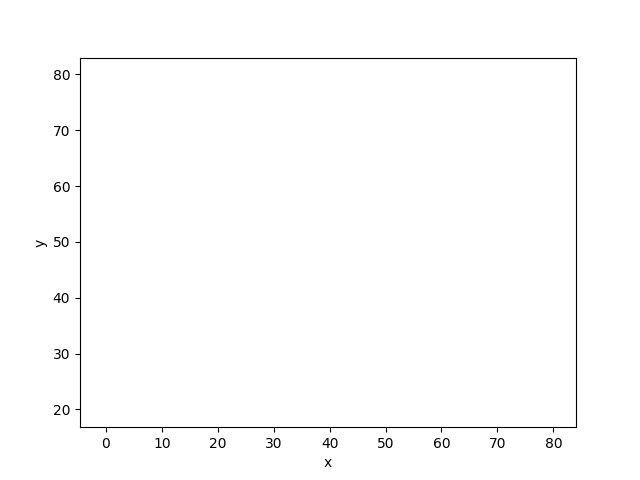

In [32]:
sections_file_name = "C"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = is_intersection_with_visualization(sections)
vis.show_gif()

[((859.9488985183879, 441.34424654286084), (922.4464209557924, 669.0778473873946)), ((645.7493603105314, 943.2786045140967), (739.9708433518083, 986.3299793326556)), ((525.989014296185, 554.3179634236236), (792.0896797921057, 485.78740817826093)), ((945.1870536778255, 107.95817625538906), (958.6026565258451, 929.5472843248313)), ((213.0383142111527, 203.8733092321151), (802.5948741523725, 960.1860156223588)), ((791.1217703373095, 950.984820111659), (983.0219956876042, 84.42438426899979)), ((433.3888558249475, 802.4561041262308), (800.6097293287951, 241.47174441440245)), ((914.6048593892883, 866.1764015406867), (933.4751640842625, 512.71257966419)), ((515.4221718701897, 103.5052314186905), (696.657000728806, 347.0900631195382)), ((426.736714982473, 739.0952904101334), (701.3418994545955, 352.07011046505863)), ((406.5928603139864, 752.5672946335956), (944.27824019145, 22.855769503791535)), ((812.0887577230376, 939.7677413678219), (998.1103503322449, 835.9558994960897)), ((629.17374733726

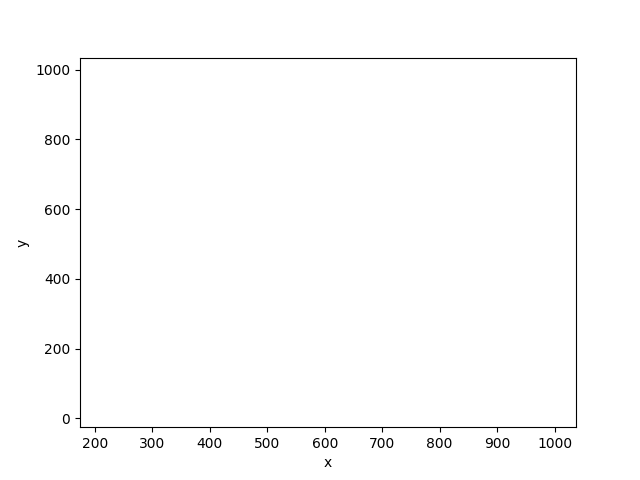

In [33]:
sections_file_name = "D"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = is_intersection_with_visualization(sections)
vis.show_gif()

[((20.0, 40.0), (80.0, 41.0)), ((15.0, 19.0), (40.0, 60.0)), ((60.0, 20.0), (85.0, 60.0)), ((25.0, 60.0), (75.0, 20.0))]


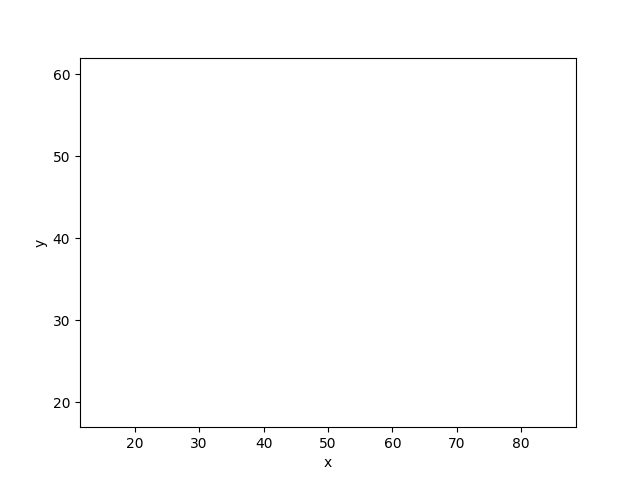

In [34]:
sections_file_name = "A"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = find_intersections_with_visualization(sections)
vis.show_gif()

[((0.251612903225805, 39.77477477477479), (39.99354838709677, 79.993564993565)), ((60.148387096774194, 19.504504504504524), (99.89032258064518, 60.045045045045065)), ((68.94838709677418, 39.77477477477479), (89.6709677419355, 60.36679536679538)), ((10.187096774193549, 40.09652509652511), (30.34193548387097, 59.40154440154442)), ((19.838709677419352, 39.77477477477479), (24.664516129032258, 19.826254826254846)), ((80.01935483870969, 60.68854568854571), (74.90967741935484, 79.6718146718147)), ((43.4, 50.392535392535414), (55.89032258064517, 50.71428571428573)), ((45.67096774193548, 43.63577863577866), (52.767741935483876, 43.95752895752897)), ((46.52258064516129, 57.47104247104249), (50.78064516129033, 57.79279279279282))]


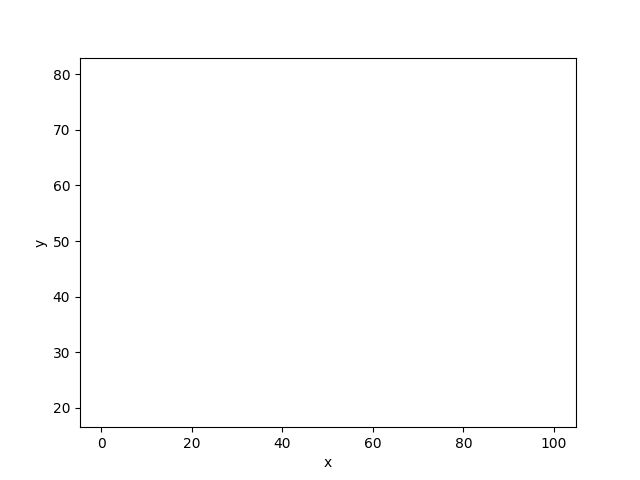

In [35]:
sections_file_name = "B"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = find_intersections_with_visualization(sections)
vis.show_gif()

[((0.5354838709677416, 79.993564993565), (80.01935483870969, 19.826254826254846)), ((-0.6000000000000014, 20.14800514800517), (79.32832258064518, 79.02831402831404)), ((0.7954193548387067, 46.209781209781234), (10.790516129032255, 60.68854568854571)), ((9.933793548387094, 51.03603603603606), (15.64527741935484, 40.418275418275435)), ((18.786593548387096, 46.85328185328188), (25.354800000000004, 55.21879021879024)), ((27.92496774193549, 50.71428571428573), (29.638412903225813, 46.209781209781234)), ((47.05843870967743, 48.14028314028315), (49.343032258064525, 51.357786357786374)), ((52.76992258064517, 55.862290862290884), (58.48140645161291, 45.24453024453026)), ((60.766000000000005, 40.09652509652511), (67.6197806451613, 50.392535392535414)), ((67.04863225806453, 61.33204633204635), (74.18798709677421, 47.49678249678251))]


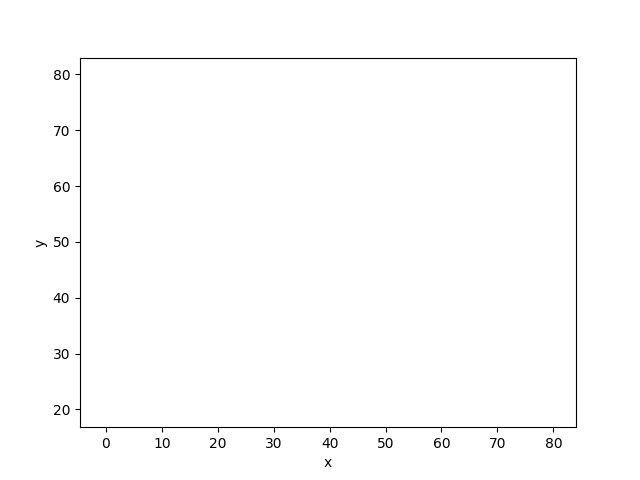

In [36]:
sections_file_name = "C"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = find_intersections_with_visualization(sections)
vis.show_gif()

[((859.9488985183879, 441.34424654286084), (922.4464209557924, 669.0778473873946)), ((645.7493603105314, 943.2786045140967), (739.9708433518083, 986.3299793326556)), ((525.989014296185, 554.3179634236236), (792.0896797921057, 485.78740817826093)), ((945.1870536778255, 107.95817625538906), (958.6026565258451, 929.5472843248313)), ((213.0383142111527, 203.8733092321151), (802.5948741523725, 960.1860156223588)), ((791.1217703373095, 950.984820111659), (983.0219956876042, 84.42438426899979)), ((433.3888558249475, 802.4561041262308), (800.6097293287951, 241.47174441440245)), ((914.6048593892883, 866.1764015406867), (933.4751640842625, 512.71257966419)), ((515.4221718701897, 103.5052314186905), (696.657000728806, 347.0900631195382)), ((426.736714982473, 739.0952904101334), (701.3418994545955, 352.07011046505863)), ((406.5928603139864, 752.5672946335956), (944.27824019145, 22.855769503791535)), ((812.0887577230376, 939.7677413678219), (998.1103503322449, 835.9558994960897)), ((629.17374733726

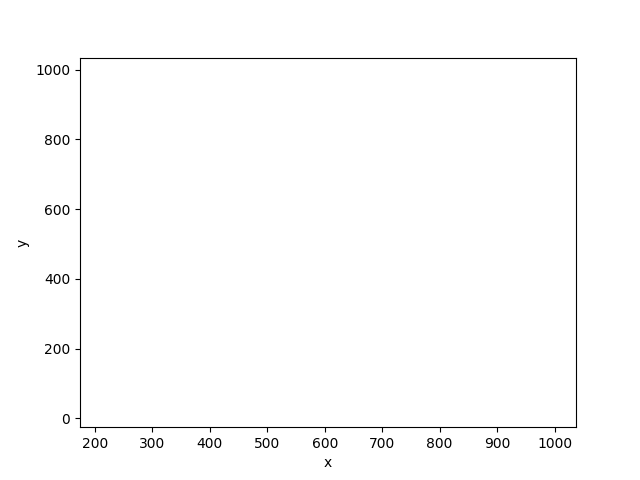

In [37]:
sections_file_name = "D"
sections = read_sections(sections_file_name)
print(sections)
answer, vis = find_intersections_with_visualization(sections)
vis.show_gif()